In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
from plotnine import (
    ggplot,
    aes,
    geom_histogram,
    geom_col,
    geom_map,
    facet_grid,
    labs,
    guide_legend,
    guides,
    theme,
    element_text,
    element_line,
    element_rect,
    theme_set,
    theme_void,
    theme_538,
    coord_flip,
    scale_color_cmap,
    scale_x_discrete
)

# Load data

## Load the UK census data from for London from GeoPackage file `data/london.gpkg` with `st_read()` from `sf` package:


In [3]:
london = gpd.read_file('./data/london.gpkg')

## Check the structure of the dataset and its coordinate reference system


In [4]:
london.crs

<Projected CRS: EPSG:32630>
Name: WGS 84 / UTM zone 30N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 6°W and 0°W, northern hemisphere between equator and 84°N, onshore and offshore. Algeria. Burkina Faso. Côte' Ivoire (Ivory Coast). Faroe Islands - offshore. France. Ghana. Gibraltar. Ireland - offshore Irish Sea. Mali. Mauritania. Morocco. Spain. United Kingdom (UK).
- bounds: (-6.0, 0.0, 0.0, 84.0)
Coordinate Operation:
- name: UTM zone 30N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [5]:
london.head()

,pers8phhd,pers7hhd,pers6hhd,pers5hhd,pers4hhd,pers3hhd,pers2hhd,pers1hhd,car4plus,car3,...,tot16to74,totadult,totpop01,totpop,popy,popx,oacode,oaid,code,geometry
0,1.0,1.0,2.0,5.0,10.0,20.0,25.0,50.0,0.0,0.0,...,187.0,194.0,191.0,252.0,176202.42,529179.73,E00015333,14933.0,E00015333,"MULTIPOLYGON (((698480.085 5705854.755, 698433..."
1,0.0,0.0,1.0,5.0,9.0,23.0,41.0,76.0,0.0,0.0,...,260.0,271.0,292.0,294.0,180050.85,532218.01,E00019783,19269.0,E00019783,"MULTIPOLYGON (((701647.971 5709748.393, 701544..."
2,0.0,0.0,3.0,3.0,16.0,43.0,35.0,39.0,0.0,0.0,...,261.0,272.0,278.0,335.0,183141.27,532651.95,E00008903,8673.0,E00008903,"MULTIPOLYGON (((701827.471 5713081.010, 701874..."
3,0.0,1.0,2.0,13.0,15.0,25.0,44.0,46.0,0.0,2.0,...,308.0,314.0,315.0,356.0,174964.73,531218.69,E00015345,14945.0,E00015345,"MULTIPOLYGON (((700621.056 5704666.594, 700583..."
4,0.0,0.0,0.0,2.0,5.0,12.0,28.0,29.0,0.0,0.0,...,117.0,122.0,239.0,151.0,179712.00,532962.00,E00020041,19503.0,E00020041,"MULTIPOLYGON (((702238.882 5709504.958, 702235..."


In [ ]:
london.columns.to_list()

## Plot a histogram for `totpop` (Total Population). Consult with `data/CensusVar.xlsx` file for full codebook for this dataset.


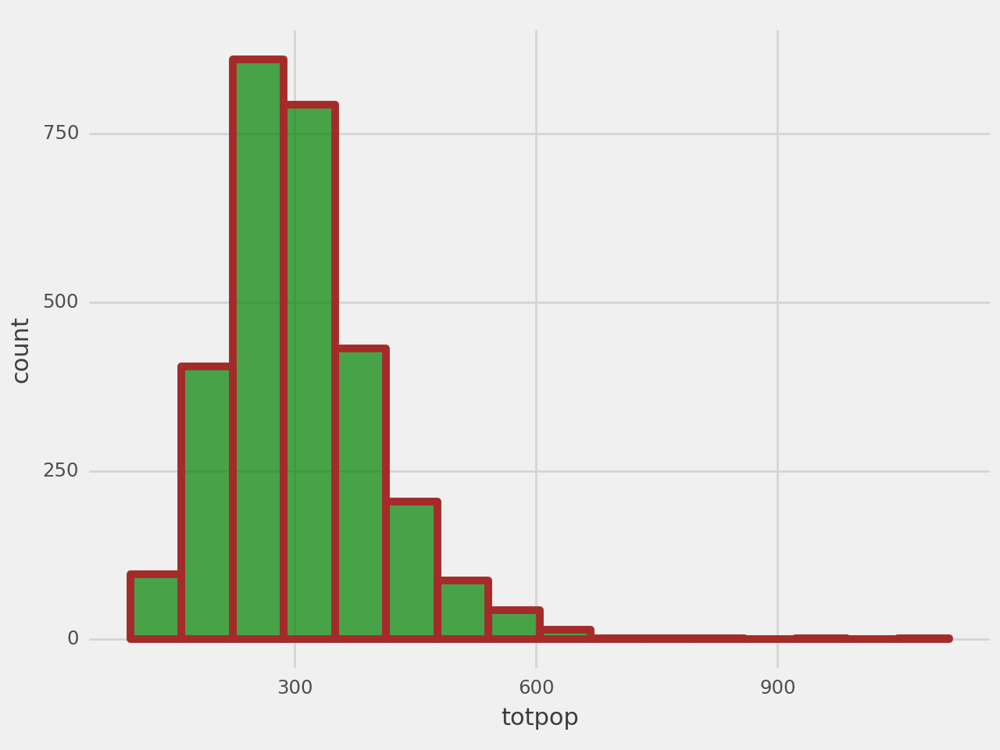

<Figure Size: (640 x 480)>

In [7]:
(ggplot(london, aes(x='totpop'))
 + geom_histogram(bins=16,
                    fill='green',  
                    colour='brown', 
                    size=2,        
                    alpha=0.7      
                    )
 + theme_538()                 
)

You may try plotting the geographic data with `plot(your_london_dataset_name %>% st_geometry, lwd = 0.1)` to see its extents, you can also use tmap or mapview packages.


In [8]:
london.explore(column='totpop', scheme='StdMean', tooltip=['totpop', 'oacode'])

# Select variables for analysis

Consult the codebook for the dataset `data/CensusVar.xlsx`. Either select your own variables or stick with the instructor's choice of variables: vghealth, ttwcar, ttwtube, ttwfoot, married, single, eaempft, eaemppt. If you select your own variables, make sure you have select on that you think may be an dependent variable for regression analysis, and 3-4 variables that may be independent variables that you would use to explain the first variable.

Part of the code is written for you. With `sf` objects it is convenient to chain the commands to select the variables and then drop the geometry, so that R does not try to use geometry as one of the variables in your dataset. Rename the datasets below according to your actual object names:


In [9]:
london_choice = london[['vghealth', 'ttwcar', 'ttwtube', 'ttwfoot', 'married', 'single', 'eaempft', 'eaemppt', 'tototrel', 'dwunshared']]

# Explore the relationships between variables with either scatterplots or corrgrams


In [10]:
london_choice.head()

,vghealth,ttwcar,ttwtube,ttwfoot,married,single,eaempft,eaemppt,tototrel,dwunshared
0,142.0,20.0,28.0,10.0,45.0,105.0,91.0,21.0,27.0,116.0
1,167.0,10.0,50.0,69.0,57.0,167.0,139.0,16.0,19.0,158.0
2,172.0,15.0,21.0,35.0,64.0,146.0,77.0,35.0,72.0,138.0
3,187.0,17.0,119.0,15.0,61.0,226.0,176.0,23.0,23.0,154.0
4,83.0,6.0,22.0,20.0,19.0,69.0,47.0,23.0,16.0,76.0


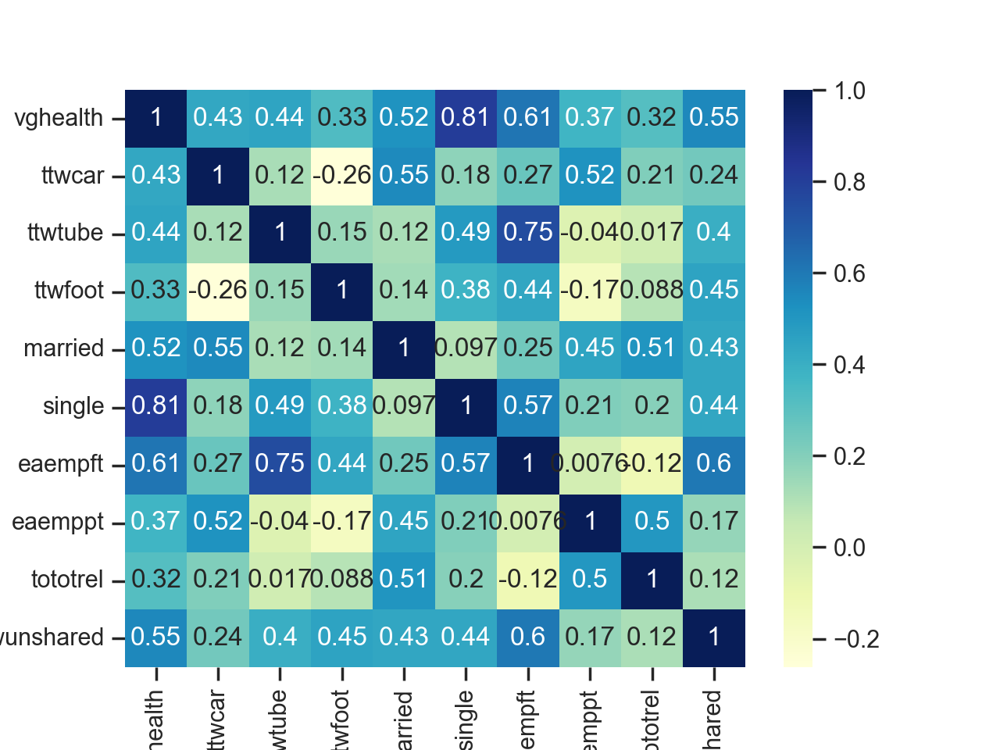

In [11]:
sns.set_theme(style="ticks")
dataplot = sns.heatmap(london_choice.corr(), cmap="YlGnBu", annot=True) 
plt.show() 

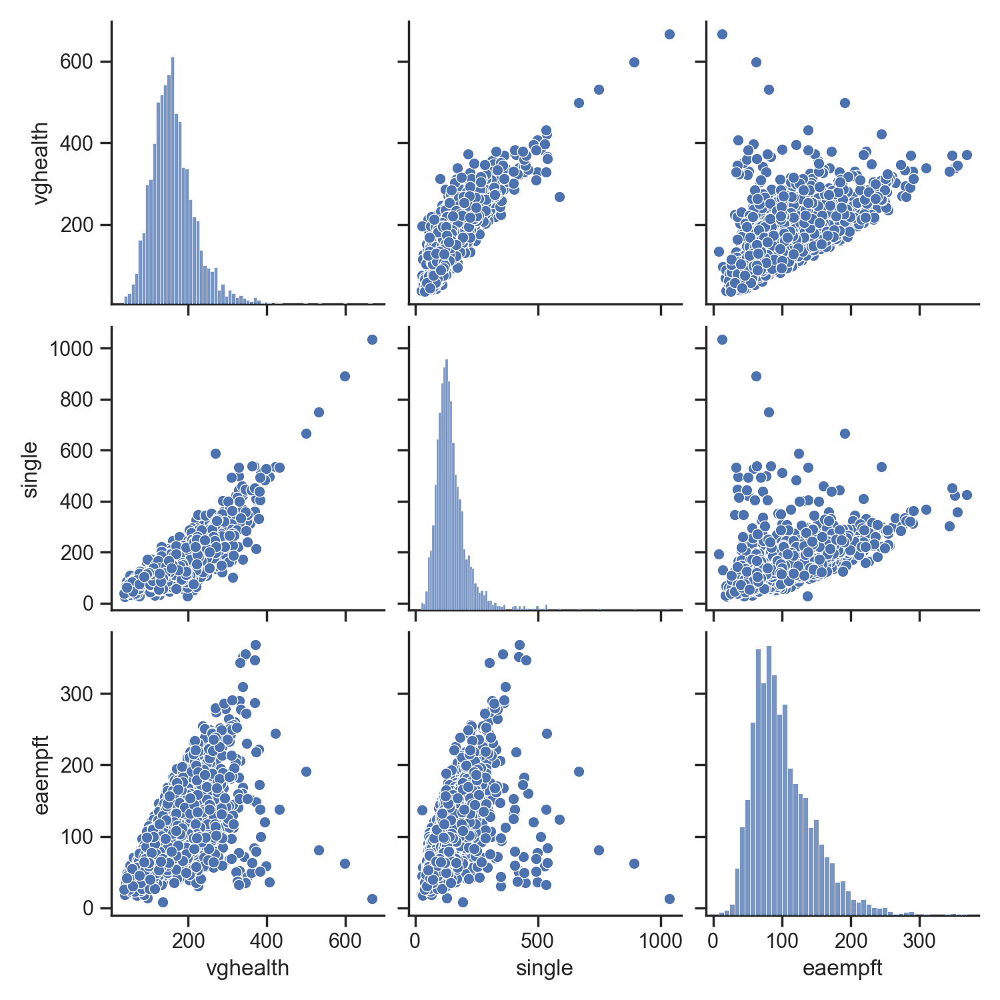

In [12]:
g = sns.pairplot(london_choice[['vghealth', 'single', 'eaempft']])
plt.show()

# Create an sf object with the the same variables as you used in the corrgram or scatterplots above

Basically you can reuse the code from two steps before but remove the part where you set the geometry to NULL. Give this sf object a different name:


In [13]:
london_choice2 = london[['vghealth', 'ttwcar', 'ttwtube', 'ttwfoot', 'married', 'single', 'eaempft', 'eaemppt', 'tototrel', 'dwunshared', 'geometry']]

# Plot the resulting sf object

Use any map plotting function to visualise the borders of the data set polygons.


In [14]:
london_choice2.explore(column='vghealth', scheme = 'NaturalBreaks')

# Using `poly2nb()` function from `spdep` identify the neighbours for each census tract in the dataset (use your last sf object) and save to a new object


In [15]:
from libpysal.weights import Queen, Rook, KNN

In [16]:
w_queen = Queen.from_dataframe(london_choice2)
ax = london_choice2.plot(edgecolor='grey', facecolor='w')
f,ax = w_queen.plot(london_choice2, ax=ax,
        edge_kws=dict(color='r', linestyle=':', linewidth=1),
        node_kws=dict(marker=''))
ax.set_axis_off()

C:\Users\Peks\AppData\Local\Temp\ipykernel_14280\3563203864.py:1: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning


# Plot the neibourhood structure


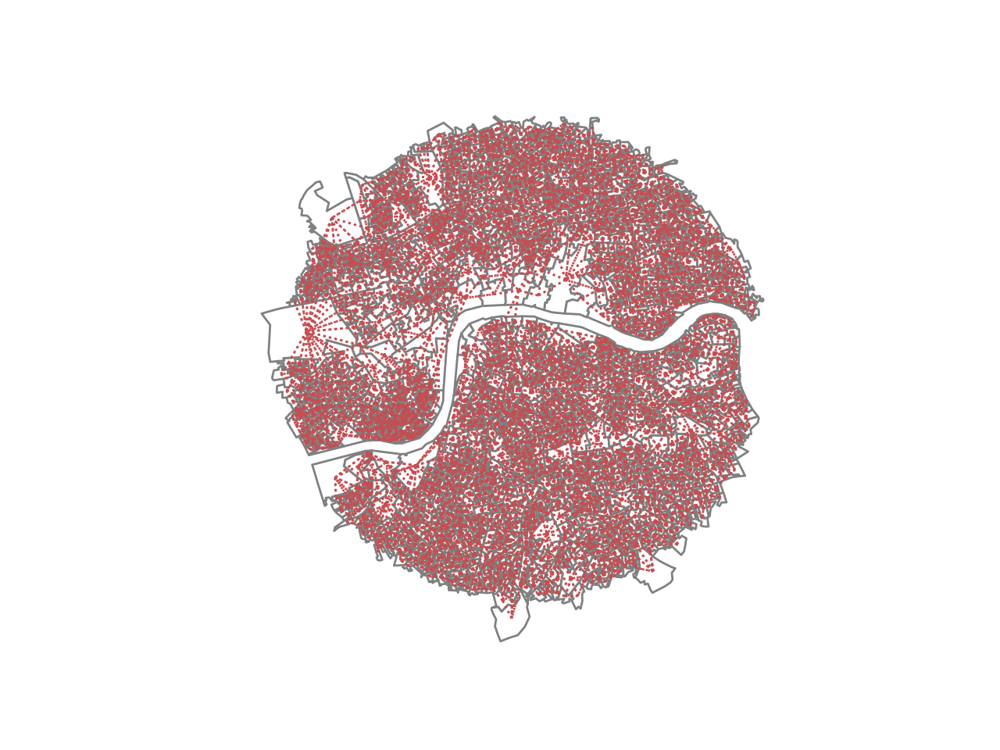

In [17]:
plt.show()

# Calculate the number of neighbours for every census tract and build a histogram of the number of neigbours


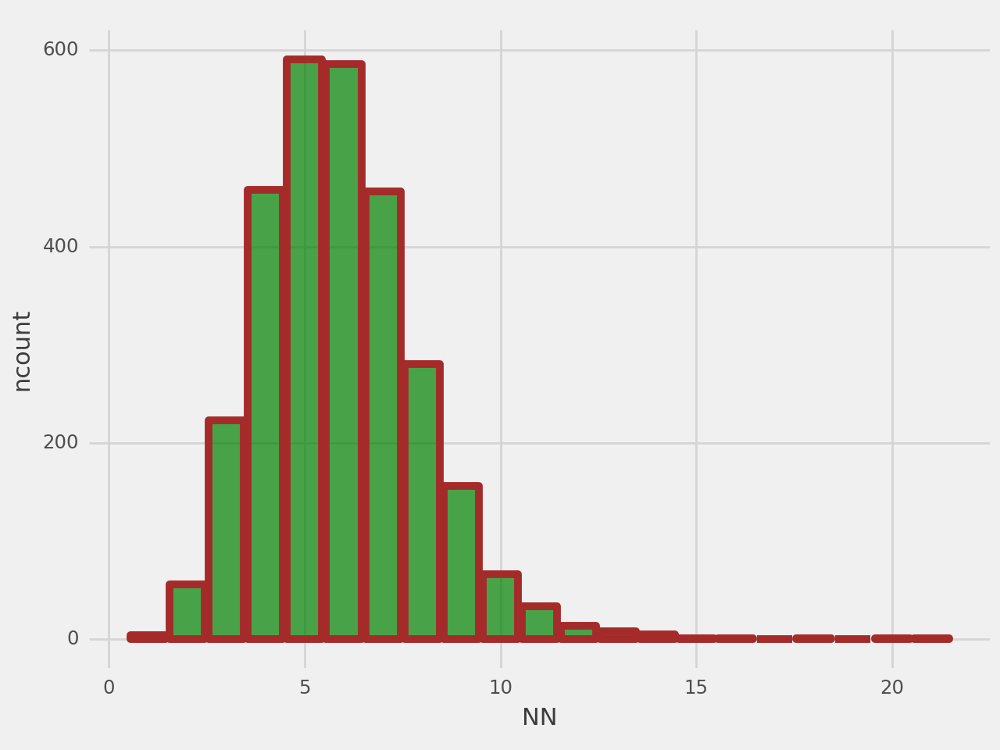

<Figure Size: (640 x 480)>

In [18]:
hist_w = pd.DataFrame([[b,i] for (b, i) in w_queen.histogram], columns=['NN', 'ncount'])
(ggplot(hist_w, aes(x='NN', y='ncount'))
 + geom_col(
                    fill='green',  
                    colour='brown', 
                    size=2,        
                    alpha=0.7      
                    )
 + theme_538()                 
)

# Create a Weights matrix. Use `nb2listw()` from `spdep` and your poly2nb object


In [19]:
from esda.moran import (Moran, Moran_BV,
                        Moran_Local, Moran_Local_BV)
from splot.esda import moran_scatterplot

In [20]:
matrix = w_queen.sparse

# Create Moran Plots for `vghealth` and `eaempft` variables (or any other variables that you may have chosen instead, one dependent and one independent). Scale the variables using `scale()` in advance.


In [21]:
y = london_choice2['vghealth']
x = london_choice2['eaempft']
w_queen.transform = 'r'

In [22]:
moran_h = Moran(y, w_queen)
moran_e = Moran(x, w_queen)

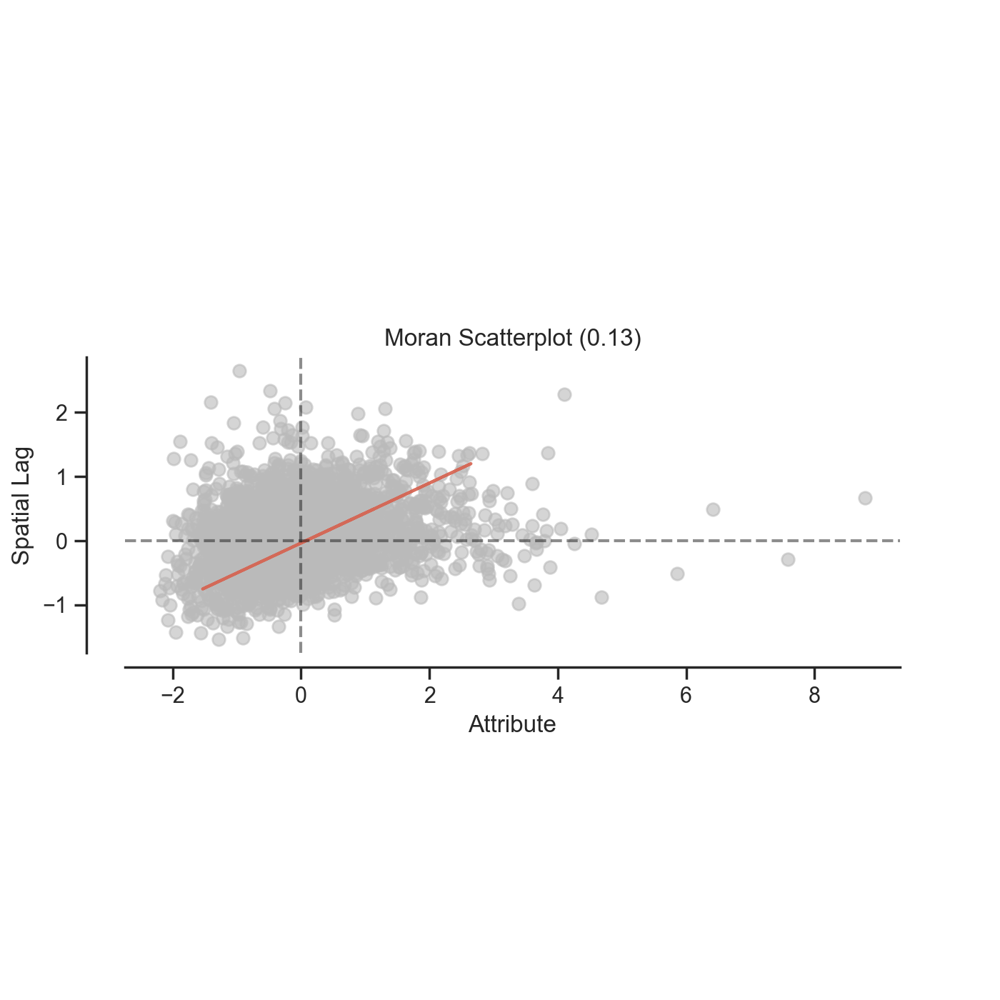

In [23]:
moran_scatterplot(moran_h, aspect_equal=True)
plt.show()

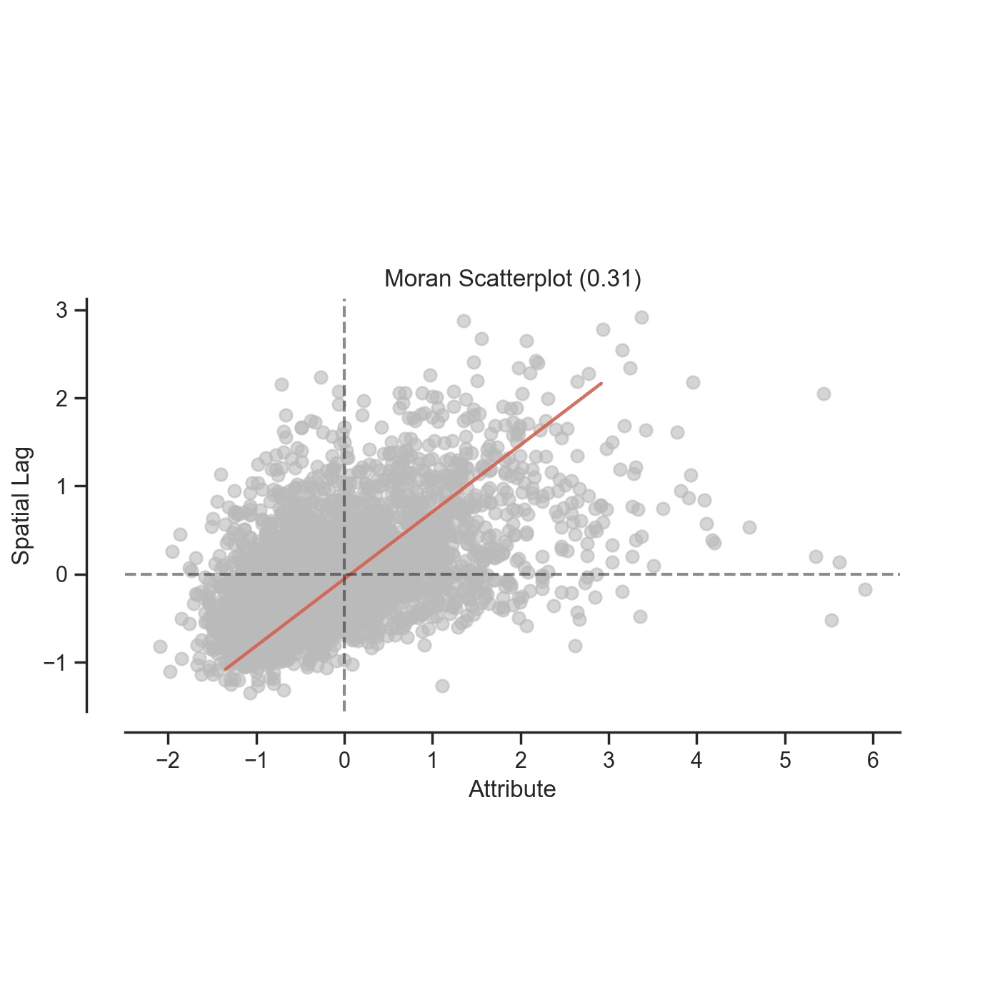

In [24]:
moran_scatterplot(moran_e, aspect_equal=True)
plt.show()

# Perform global Moran test for `vghealth` and `eaempft` variables (or any other variables that you may have chosen instead, one dependent and one independent)


In [25]:
moran_h.I

0.1306488941819887

In [26]:
moran_h.p_sim

0.001

In [27]:
moran_e.I

0.308475933716312

In [28]:
moran_e.p_sim

0.001

Very little evidence of spatial autocorrelation.

# Calculate local moran for the same two variables


In [29]:
moran_lh = Moran_Local(y, w_queen)
moran_le = Moran_Local(x, w_queen)

# Add the calculated local moran significance values as new columns to the sf census tracts object you are working with

Make sure you name the new columns so that you know which significance level is which


In [30]:
london_choice2['vghealth_sig'] = moran_lh.Is
london_choice2['eaempft_sig'] = moran_le.Is

C:\Stuff_snuff\myvenv\lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Stuff_snuff\myvenv\lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


# Explore the strucure of the resulting object


In [31]:
london_choice2

,vghealth,ttwcar,ttwtube,ttwfoot,married,single,eaempft,eaemppt,tototrel,dwunshared,geometry,vghealth_sig,eaempft_sig
0,142.0,20.0,28.0,10.0,45.0,105.0,91.0,21.0,27.0,116.0,"MULTIPOLYGON (((698480.085 5705854.755, 698433...",-0.398075,-0.393072
1,167.0,10.0,50.0,69.0,57.0,167.0,139.0,16.0,19.0,158.0,"MULTIPOLYGON (((701647.971 5709748.393, 701544...",-0.002213,0.167450
2,172.0,15.0,21.0,35.0,64.0,146.0,77.0,35.0,72.0,138.0,"MULTIPOLYGON (((701827.471 5713081.010, 701874...",-0.050728,0.347541
3,187.0,17.0,119.0,15.0,61.0,226.0,176.0,23.0,23.0,154.0,"MULTIPOLYGON (((700621.056 5704666.594, 700583...",0.029462,0.710631
4,83.0,6.0,22.0,20.0,19.0,69.0,47.0,23.0,16.0,76.0,"MULTIPOLYGON (((702238.882 5709504.958, 702235...",-0.434434,-0.840324
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2937,124.0,15.0,12.0,13.0,74.0,54.0,53.0,8.0,25.0,112.0,"MULTIPOLYGON (((697484.518 5708581.967, 697414...",-0.010487,0.473974
2938,157.0,18.0,47.0,35.0,126.0,138.0,79.0,30.0,207.0,137.0,"MULTIPOLYGON (((704463.210 5711381.713, 704462...",-0.021671,0.075817
2939,130.0,12.0,29.0,7.0,48.0,86.0,65.0,25.0,18.0,115.0,"MULTIPOLYGON (((700962.938 5704786.977, 701001...",-0.079205,-0.218685
2940,127.0,15.0,40.0,33.0,73.0,117.0,117.0,9.0,27.0,116.0,"MULTIPOLYGON (((698777.075 5713677.762, 698767...",-0.147638,-0.150806


# Plot the significance levels for the two variables on two separate maps


In [32]:
london_choice2.explore(column='vghealth_sig', scheme = 'stdmean')

In [33]:
london_choice2.explore(column='eaempft_sig', scheme = 'stdmean')

# Have a look at the correlation matrix again and select variables for simple or multiple regression

You may keep all the variables if that is appropriate.


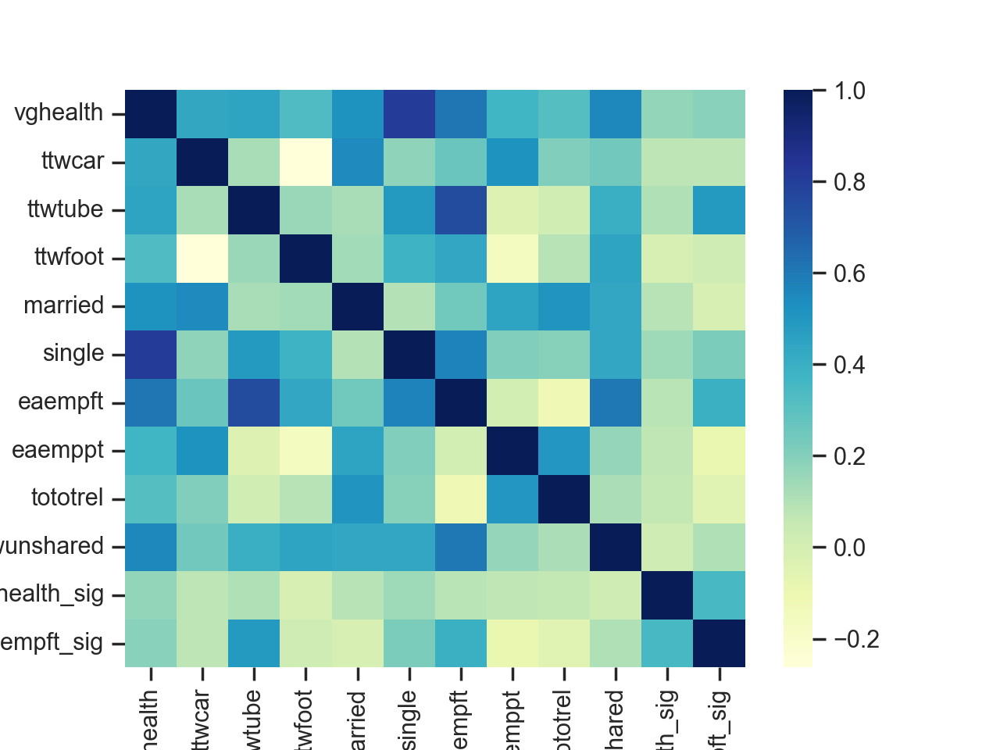

In [34]:
dataplot = sns.heatmap(london_choice2.drop(columns=['geometry']).corr(), cmap="YlGnBu", annot=False) 
plt.show()

# Using your selected variables create a multiple linear regression model


In [35]:
y = np.array(london_choice['vghealth'])
y.shape = (len(london_choice['vghealth']), 1)

In [36]:
x = np.array(london_choice.drop(['vghealth'], axis=1))

In [37]:
from spreg import OLS, ML_Lag, ML_Error, akaike
import spreg

ols = OLS(y, x, \
                  w=w_queen, spat_diag=True, \
                  name_x=london_choice.drop(['vghealth'], axis=1).columns.tolist(), name_y='vghealth')

# View model summary


In [38]:
print(ols.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :    vghealth                Number of Observations:        2942
Mean dependent var  :    162.0897                Number of Variables   :          10
S.D. dependent var  :     57.4989                Degrees of Freedom    :        2932
R-squared           :      0.8664
Adjusted R-squared  :      0.8660
Sum squared residual: 1.29893e+06                F-statistic           :   2112.8628
Sigma-square        :     443.020                Prob(F-statistic)     :           0
S.E. of regression  :      21.048                Log likelihood        :  -13133.215
Sigma-square ML     :     441.514                Akaike info criterion :   26286.430
S.E of regression ML:     21.0122                Schwarz criterion     :   26346.299

------------------------------------------------------------

In [39]:
from sklearn.linear_model import SGDRegressor, LinearRegression
from sklearn.svm import LinearSVC
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

In [40]:
reg = LinearRegression().fit(london_choice.drop(['vghealth'], axis=1), london_choice['vghealth'])

In [41]:
pd.DataFrame({
    'feature': london_choice.drop(['vghealth'], axis=1).columns,
    'importance': reg.coef_
}).sort_values(by='importance', ascending=False).reset_index(drop=True)

,feature,importance
0,married,0.864778
1,single,0.616252
2,eaempft,0.217570
3,eaemppt,0.129787
4,ttwcar,0.039354
5,dwunshared,0.013360
6,tototrel,-0.026362
7,ttwfoot,-0.159404
8,ttwtube,-0.164637


In [42]:
reg.score(london_choice.drop(['vghealth'], axis=1), london_choice['vghealth'])

0.8664100892044303

# Copy the model residuals to the dataset itself and plot the residuals on a map


In [43]:
london_choice2['resid'] = reg.predict(london_choice.drop(['vghealth'], axis=1)) - london_choice['vghealth'].mean()

C:\Stuff_snuff\myvenv\lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [44]:
london_choice2.explore(column='resid', scheme = 'stdmean', cmap='viridis')

# Plot model residuals analysis


In [45]:
from yellowbrick.regressor import ResidualsPlot

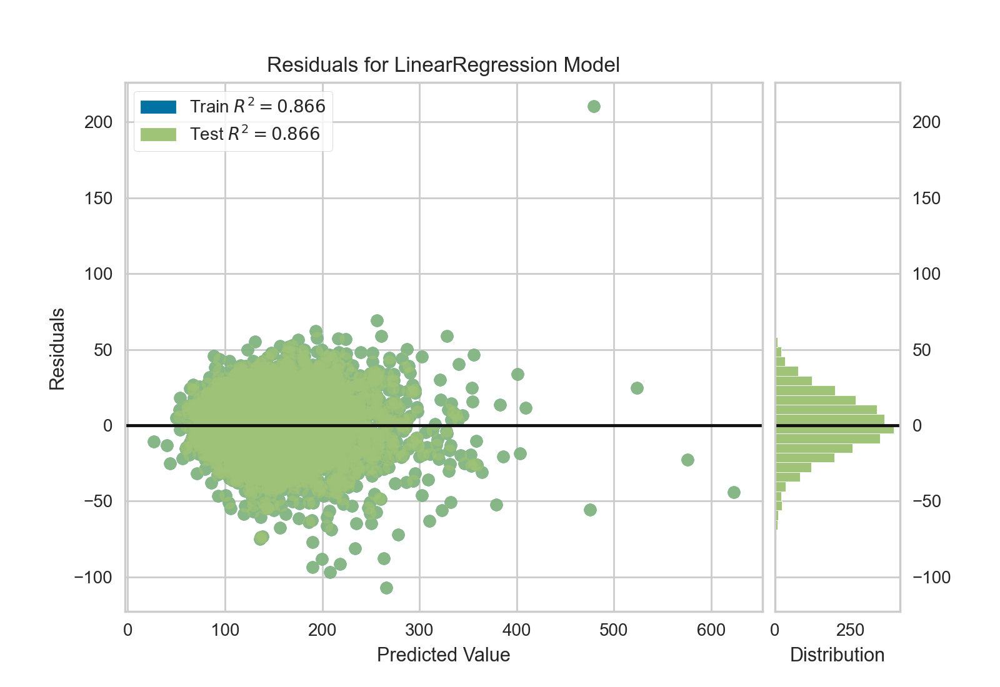

<Axes: title={'center': 'Residuals for LinearRegression Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [46]:
model = LinearRegression()
visualizer = ResidualsPlot(model)

visualizer.fit(london_choice.drop(['vghealth'], axis=1), london_choice['vghealth'])
visualizer.score(london_choice.drop(['vghealth'], axis=1), london_choice['vghealth'])
visualizer.show()

# Perform global Moran lm test


In [47]:
m = spreg.MoranRes(ols, w_queen, z=True)

In [48]:
m.I

0.13411548526485847

# Perform Lagrange Multiplier diagnostics for spatial lag and spatial error


In [49]:
print(ols.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :    vghealth                Number of Observations:        2942
Mean dependent var  :    162.0897                Number of Variables   :          10
S.D. dependent var  :     57.4989                Degrees of Freedom    :        2932
R-squared           :      0.8664
Adjusted R-squared  :      0.8660
Sum squared residual: 1.29893e+06                F-statistic           :   2112.8628
Sigma-square        :     443.020                Prob(F-statistic)     :           0
S.E. of regression  :      21.048                Log likelihood        :  -13133.215
Sigma-square ML     :     441.514                Akaike info criterion :   26286.430
S.E of regression ML:     21.0122                Schwarz criterion     :   26346.299

------------------------------------------------------------

# Spatial models. Build a Spatial Lag model

This may take 2-5 minutes.


In [50]:
mll = ML_Lag(y, x, \
                  w=w_queen, \
                  name_x=london_choice.drop(['vghealth'], axis=1).columns.tolist(), name_y='vghealth')

# View Spatial Lag model summary


In [51]:
print(mll.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: MAXIMUM LIKELIHOOD SPATIAL LAG (METHOD = FULL)
-----------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :    vghealth                Number of Observations:        2942
Mean dependent var  :    162.0897                Number of Variables   :          11
S.D. dependent var  :     57.4989                Degrees of Freedom    :        2931
Pseudo R-squared    :      0.8672
Spatial Pseudo R-squared:  0.8654
Log likelihood      : -13124.6346
Sigma-square ML     :    438.7381                Akaike info criterion :   26271.269
S.E of regression   :     20.9461                Schwarz criterion     :   26337.125

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
---------------------------------------------------------------

# Spatial models. Build a Spatial Error Model

This may take 2-5 minutes


In [52]:
mle = ML_Error(y, x, \
                  w=w_queen, \
                  name_x=london_choice.drop(['vghealth'], axis=1).columns.tolist(), name_y='vghealth')

C:\Stuff_snuff\myvenv\lib\site-packages\scipy\optimize\_minimize.py:913: RuntimeWarning: Method 'bounded' does not support relative tolerance in x; defaulting to absolute tolerance.


# View Spatial Error model summary


In [53]:
print(mle.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ML SPATIAL ERROR (METHOD = full)
---------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :    vghealth                Number of Observations:        2942
Mean dependent var  :    162.0897                Number of Variables   :          10
S.D. dependent var  :     57.4989                Degrees of Freedom    :        2932
Pseudo R-squared    :      0.8658
Log likelihood      : -13067.2664
Sigma-square ML     :    414.2119                Akaike info criterion :   26154.533
S.E of regression   :     20.3522                Schwarz criterion     :   26214.401

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT        -2.40034    

# Evaluation of other models


In [54]:
x_train, x_test, y_train, y_test = train_test_split(london_choice.drop(['vghealth'], axis=1), london_choice['vghealth'])

In [55]:
sgdr = SGDRegressor(early_stopping=True)
param_grid = {'penalty': ['l1', 'l2', 'elasticnet', None],
              'loss': ['squared_error', 'huber', 'epsilon_insensitive'],
              'max_iter': [128, 256, 512, 1024, 2048]}

In [56]:
grid_reg = GridSearchCV(sgdr, param_grid, scoring='r2', verbose=1)

In [57]:
grid_reg.fit(london_choice.drop(['vghealth'], axis=1), london_choice['vghealth'])

Fitting 5 folds for each of 60 candidates, totalling 300 fits


GridSearchCV(estimator=SGDRegressor(early_stopping=True),
             param_grid={'loss': ['squared_error', 'huber',
                                  'epsilon_insensitive'],
                         'max_iter': [128, 256, 512, 1024, 2048],
                         'penalty': ['l1', 'l2', 'elasticnet', None]},
             scoring='r2', verbose=1)

In [58]:
best_reg = grid_reg.best_estimator_

In [59]:
grid_reg.best_score_

0.854390701744127

In [60]:
import catboost as cb
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

In [61]:
train_dataset = cb.Pool(x_train, y_train) 
test_dataset = cb.Pool(x_test, y_test)

In [62]:
model2 = cb.CatBoostRegressor(loss_function='RMSE')

In [ ]:
grid = {'iterations': [100, 150, 200, 400, 800, 1000],
        'learning_rate': [0.03, 0.1],
        'depth': [2, 4, 6, 8],
        'l2_leaf_reg': [0.2, 0.5, 1, 3]}
model2.grid_search(grid, train_dataset)

In [64]:
pred = model2.predict(x_test)
rmse = (np.sqrt(mean_squared_error(y_test, pred)))
r2 = r2_score(y_test, pred)
print('Testing performance')
print('RMSE: {:.2f}'.format(rmse))
print('R2: {:.5f}'.format(r2))

Testing performance
RMSE: 24.77
R2: 0.85049


In [65]:
params = {'eval_metric':'R2',
          'early_stopping_rounds': 200,
          'verbose': 200,
         }
cb_reg = cb.CatBoostRegressor(**params)
cb_reg.fit(x_train, y_train, eval_set=(x_test, y_test), use_best_model=True, plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Learning rate set to 0.057656
0:	learn: 0.0665767	test: 0.0539593	best: 0.0539593 (0)	total: 1.72ms	remaining: 1.72s
200:	learn: 0.9055679	test: 0.8359452	best: 0.8359452 (200)	total: 299ms	remaining: 1.19s
400:	learn: 0.9329390	test: 0.8387072	best: 0.8389823 (245)	total: 590ms	remaining: 882ms
600:	learn: 0.9490135	test: 0.8391951	best: 0.8405552 (449)	total: 884ms	remaining: 587ms
Stopped by overfitting detector  (200 iterations wait)

bestTest = 0.840555157
bestIteration = 449

Shrink model to first 450 iterations.


In [66]:
cb_reg.best_score_

{'learn': {'R2': 0.9521226971458234, 'RMSE': 12.05714338949831},
 'validation': {'R2': 0.8405551570442369, 'RMSE': 25.575258933018812}}

# Compare the model summaries and select the best model

It may be the case that none of the models are any better that ordinary regression. This is fine.

Provide your code for model comparison (this may include charts and/or maps) below:


In [67]:
akaike(ols)

26286.430367158828

In [68]:
akaike(mll)

26271.269221511968

In [69]:
akaike(mle)

26154.53286469201

# Print the best model's summary below


In [70]:
feat_importances = cb_reg.get_feature_importance(prettified=True)
feat_importances

,Feature Id,Importances
0,single,41.345757
1,married,24.912174
2,eaempft,8.974851
3,eaemppt,6.961188
4,tototrel,4.638389
5,ttwcar,4.211241
6,dwunshared,3.823119
7,ttwfoot,2.833133
8,ttwtube,2.300149


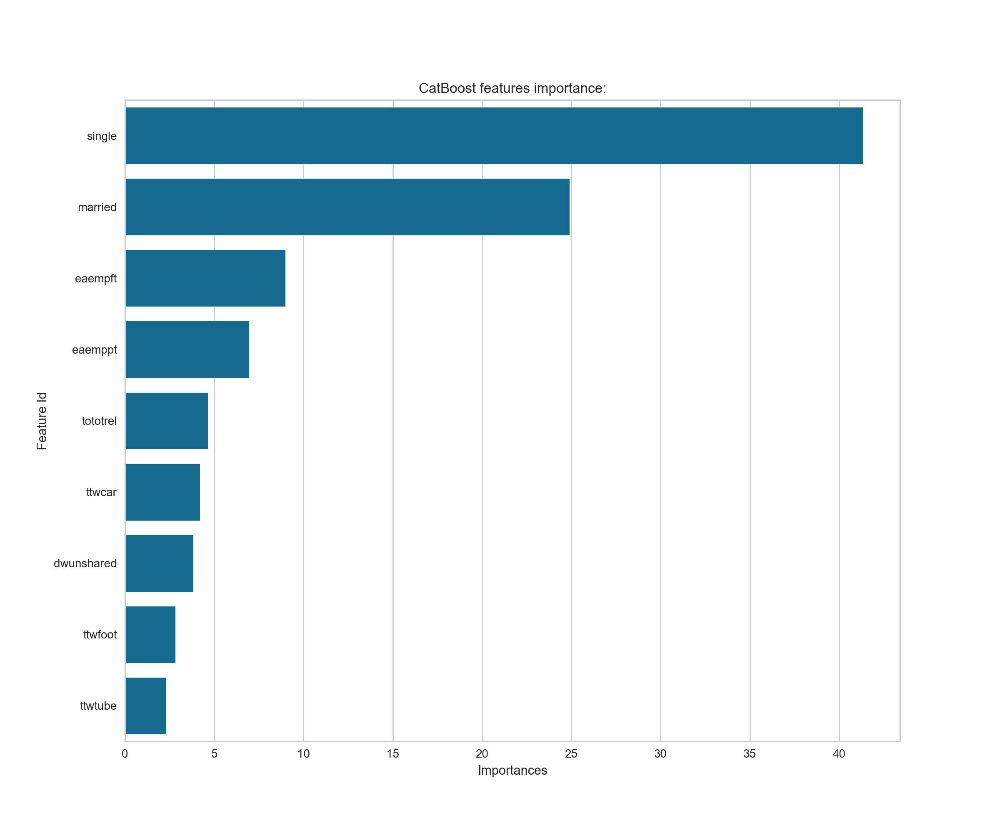

In [71]:
plt.figure(figsize=(12, 10))
sns.barplot(x="Importances", y="Feature Id", data=feat_importances.loc[:30, :])
plt.title('CatBoost features importance:')
plt.show()

In [72]:
import shap

In [73]:
explainer = shap.TreeExplainer(cb_reg) 
shap_values = explainer.shap_values(train_dataset)

shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[:100,:], x_train.iloc[:100,:])

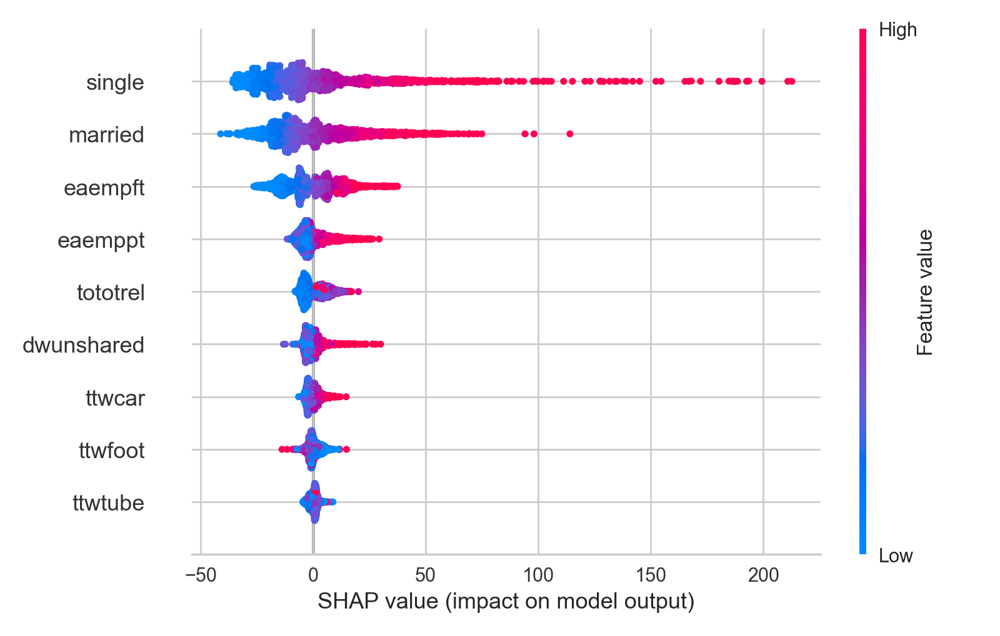

In [74]:
shap.summary_plot(shap_values, x_train)